**Import Libraries**

In [1]:
import numpy as np
import os
import pandas as pd
import torch
import torch.nn.functional as F
import torch.nn as nn
import torchvision.models as models
from matplotlib import pyplot as plt
from torchvision.transforms import ToTensor
import torch.optim as optim
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from glob import glob
import cv2
from PIL import Image
from torchvision import transforms
from torch.nn.modules import BCEWithLogitsLoss
from torch.optim.lr_scheduler import StepLR
from tqdm import tqdm
import time
import monai
from sklearn.model_selection import train_test_split
from monai.metrics import DiceMetric
from monai.losses import DiceLoss, DiceCELoss
from sklearn.metrics import accuracy_score, precision_score, recall_score

In [2]:
import random

# Set seed
seed = 42
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

**Import Pretrained Weights**

In [3]:
import torchvision.models as models
from torchvision.models.resnet import ResNet34_Weights

def replace_relu_with_leakyrelu(module):
    for name, child in module.named_children():
        if isinstance(child, nn.ReLU):
            setattr(module, name, nn.LeakyReLU(negative_slope=0.01))
        else:
            replace_relu_with_leakyrelu(child)

resnet = models.resnet34(weights=ResNet34_Weights["IMAGENET1K_V1"])
for param in resnet.parameters():
    param.requires_grad = False
    
replace_relu_with_leakyrelu(resnet)

class Encoder(nn.Module):
    def __init__(self):
        super().__init__()
        self.layer1 = nn.Sequential(
            resnet.conv1,
            resnet.bn1,
            nn.LeakyReLU(),
            resnet.layer1
        )
        self.layer2 = resnet.layer2
        self.layer3 = resnet.layer3
        self.layer4 = resnet.layer4
        
    def forward(self, x):
        x1 = self.layer1(x)
        x2 = self.layer2(x1)
        x3 = self.layer3(x2)
        x4 = self.layer4(x3)
        return x1, x2, x3, x4

**Blok Bottleneck**

In [4]:
class MiddleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=(1,1), padding=(1,1))
        self.relu1 = nn.LeakyReLU()

        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=(1,1), padding=(1,1))
        self.relu2 = nn.LeakyReLU()

        self.bn = nn.BatchNorm2d(out_channels)

    def forward(self, inputs):
        x = self.conv1(inputs)
        x = self.relu1(x)

        x = self.conv2(x)
        x = self.relu2(x)

        x = self.bn(x)

        return x

**Basic Block Resnet**

In [5]:
# basic block untuk decoder
class BasicBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=(1,1), padding=(1,1))
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.LeakyReLU()

        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=(1,1), padding=(1,1))
        self.bn2 = nn.BatchNorm2d(out_channels)

    def forward(self, inputs):
        x = self.conv1(inputs)
        x = self.bn1(x)
        x = self.relu(x)

        x = self.conv2(x)
        x = self.bn2(x)

        return x

**Blok Decoder**

In [6]:
class Dec_Block(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()

        # Up-Convolution
        self.upconv = nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)
        
        # LeakyReLU
        self.relu = nn.LeakyReLU()
        
        # Batch normalization
        self.bn = nn.BatchNorm2d(out_channels)

        # Basic Block
        self.conv = BasicBlock(in_channels // 2 + out_channels, out_channels)

    def forward(self, inputs, skip):
        up_x = self.upconv(inputs)
        up_x = self.relu(up_x)
        up_x = self.bn(up_x)  
        skip = nn.functional.interpolate(skip, size=up_x.size()[2:], mode='bilinear', align_corners=True)
        x = torch.cat([up_x, skip], dim=1)
        x = self.conv(x)

        return x

**Merge Layer**

In [7]:
class MergeLayer(nn.Module):
    def __init__(self):
        super(MergeLayer, self).__init__()

    def forward(self, x, skip):
        #x = nn.functional.interpolate(x, size=skip.size()[2:], mode='bilinear', align_corners=True)
        x = torch.cat([x, skip], dim=1)
        return x

**Build Model**

In [8]:
class Build_Unet(nn.Module):
    def __init__(self):
        super().__init__()

        """ Encoder """
        self.encoder = Encoder()

        """ Middle Convolution """
        self.mc1 = MiddleConv(512, 1024)
        self.mc2 = MiddleConv(1024, 1024)

        """ Decoder """
        self.decoder1 = Dec_Block(1024, 512)
        self.decoder2 = Dec_Block(512, 256)
        self.decoder3 = Dec_Block(256, 128)
        self.decoder4 = Dec_Block(128, 64)

        """ Merge Layer """
        self.merge = MergeLayer()

        """ Segmentation Convolution """
        self.segmentation = nn.Conv2d(67, 1, kernel_size=1, padding=0)
        
    def forward(self, x):
        """ Encoder """
        x1, x2, x3, x4 = self.encoder(x)

        mc1 = self.mc1(x4)

        """ Decoder """
        d1 = self.decoder1(mc1, x4)
        d2 = self.decoder2(d1, x3)
        d3 = self.decoder3(d2, x2)
        d4 = self.decoder4(d3, x1)

        merged = self.merge(d4, x)
        
        out = self.segmentation(merged)
        
        return out

In [9]:
inputs = torch.randn((1, 3, 512, 512))
model = Build_Unet()
y = model(inputs)

print("output shape :", y.shape)

output shape : torch.Size([1, 1, 512, 512])


**Transform Image to tensor**

In [10]:
from torchvision import transforms

class ProcessDataset(Dataset):
    def __init__(self, x, y):
        self.x = x
        self.y = y
        self.transform = transforms.ToTensor()

    def __len__(self):
        return len(self.x)

    def __getitem__(self, idx):
        img_x = Image.open(self.x[idx])
        img_y = Image.open(self.y[idx]).convert("L")

        img_x = self.transform(img_x)
        img_y = self.transform(img_y)
        
        return img_x, img_y

In [11]:
""" HYPERPARAMETERS """
BATCHSIZE = 2
EPOCHS = 50

""" DATASETS """
train_x = sorted(glob("/drive0-storage/Anastasia/CROSS VAL DATA/TRAIN IMG/*"))
train_y = sorted(glob("/drive0-storage/Anastasia/CROSS VAL DATA/GT MA/*"))
dataset = ProcessDataset(train_x, train_y)

""" DEVICE """
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = Build_Unet()
model.to(device)

Build_Unet(
  (encoder): Encoder(
    (layer1): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.01)
      (3): Sequential(
        (0): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): LeakyReLU(negative_slope=0.01)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
        (1): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     

In [12]:
from sklearn.model_selection import KFold
from torch.utils.data.dataset import Subset

# split dataset menjadi 10 subset
kf = KFold(n_splits=10, shuffle=True, random_state=42)
dice_scores = []  # Untuk menyimpan skor Dice coefficient dari setiap fold

# Inisialisasi dictionary untuk menyimpan training history
H = {}
for fold in range(10):
    H[f"train_loss_{fold}"] = []
    H[f"test_loss_{fold}"] = []
    H[f"dice_train_{fold}"] = []
    H[f"dice_val_{fold}"] = []

startTime = time.time()
# loop melalui setiap fold
for fold, (train_index, test_index) in enumerate(kf.split(dataset)):
    print(f"Fold {fold + 1}/{kf.get_n_splits()}")
    train_dataset = Subset(dataset, train_index)
    val_dataset = Subset(dataset, test_index)
    
    # inisialisasi loader pelatihan dan pengujian
    train_loader = DataLoader(train_dataset, batch_size=2, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=2, shuffle=True)
    
    # Mendapatkan jumlah data train dan validasi
    num_train_data = len(train_dataset)
    num_val_data = len(val_dataset)

    # Menampilkan jumlah data train dan validasi
    print("Jumlah data train:", num_train_data)
    print("Jumlah data validasi:", num_val_data)

    # hitung steps per epoch untuk training dan test set
    trainSteps = len(train_dataset) // BATCHSIZE
    valSteps = len(val_dataset) // BATCHSIZE
    
    LR = 1e-3
    criterion = BCEWithLogitsLoss()
    criterion.to(device)
    optimizer = optim.Adam(model.parameters(), lr=LR)

    for epoch in range(EPOCHS):
        totalTrainLoss = 0
        total_dice_train = 0
        dice_metric_train = DiceMetric(include_background=False, reduction="mean")
        all_train_preds = []
        all_train_targets = []

        # training mode
        model.train()

        for i, (data, target) in enumerate(train_loader):
            # pindahkan data ke perangkat yang sesuai
            data, target = data.to(device), target.to(device)

            # kirim data ke dalam model
            output = model(data)

            # hitung loss
            loss = criterion(output, target)

            # convert output to binary predictions
            pred = torch.round(torch.sigmoid(output))

            # backpropagation dan update parameter
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            totalTrainLoss += loss.item()

            # tambahkan prediksi dan label target ke variabel total
            all_train_preds.append(pred)
            all_train_targets.append(target)

        # gabungkan prediksi dan label target menjadi tensor yang sesuai
        all_train_preds = torch.cat(all_train_preds, dim=0)
        all_train_targets = torch.cat(all_train_targets, dim=0)

        # hitung DSC menggunakan tensor prediksi dan label target secara keseluruhan
        dice_score_train = dice_metric_train(all_train_preds, all_train_targets)
        avg_dice_train = dice_score_train.mean().item()

        with torch.no_grad():
            totalTestLoss = 0
            total_dice_val = 0
            dice_metric_val = DiceMetric(include_background=False, reduction="mean")
            all_preds = []
            all_targets = []

            # validasi mode
            model.eval()

            for i, (data, target) in enumerate(val_loader):
                # pindahkan data ke perangkat yang sesuai
                data, target = data.to(device), target.to(device)

                # kirim data ke dalam model
                output = model(data)

                # convert output to binary predictions
                pred = torch.round(torch.sigmoid(output))

                # hitung loss
                loss = criterion(output, target)
                totalTestLoss += loss.item()

                # tambahkan prediksi dan label target ke variabel total
                all_preds.append(pred)
                all_targets.append(target)
            
        # gabungkan prediksi dan label target menjadi tensor yang sesuai
        all_preds = torch.cat(all_preds, dim=0)
        all_targets = torch.cat(all_targets, dim=0)

        # hitung DSC menggunakan tensor prediksi dan label target secara keseluruhan
        dice_score_val = dice_metric_val(all_preds, all_targets)
        avg_dice_val = dice_score_val.mean().item()

        # hitung rata-rata training dan test loss
        avgTrainLoss = totalTrainLoss / trainSteps
        avgTestLoss = totalTestLoss / valSteps
        
        # Hitung rata-rata Dice coefficient untuk fold saat ini
        average_dice_score_fold = np.mean(H[f"dice_val_{fold}"])
        dice_scores.append(average_dice_score_fold)

	      # update training history
        H[f"train_loss_{fold}"].append(avgTrainLoss)
        H[f"test_loss_{fold}"].append(avgTestLoss)
        H[f"dice_train_{fold}"].append(avg_dice_train)
        H[f"dice_val_{fold}"].append(avg_dice_val)
    
        # print informasi training
        print("EPOCH: {}/{}".format(epoch + 1, EPOCHS))
        print("Train loss: {:.4f} | Val loss: {:.4f}".format(
	        avgTrainLoss, avgTestLoss))
        print("DSC Train : {:.4f} | DSC Val : {:.4f}".format(avg_dice_train, avg_dice_val))
    
    # display total waktu training
    endTime = time.time()
    print("[INFO] total time taken to train the model: {:.2f}s".format(
	    endTime - startTime))
torch.save(model.state_dict(), 'tesma10fold.pth')
    
# Hitung rata-rata Dice coefficient dari seluruh fold dalam cross-validation
average_dice_score_cv = np.mean(dice_scores)
print(f"Cross-Validation Dice coefficient: {average_dice_score_cv:.2f}")

Fold 1/10
Jumlah data train: 72
Jumlah data validasi: 9


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


EPOCH: 1/50
Train loss: 0.6613 | Val loss: 0.7353
DSC Train : 0.0221 | DSC Val : 0.0008
EPOCH: 2/50
Train loss: 0.5320 | Val loss: 0.5471
DSC Train : 0.0082 | DSC Val : 0.0000
EPOCH: 3/50
Train loss: 0.3529 | Val loss: 0.3292
DSC Train : 0.0053 | DSC Val : 0.0000
EPOCH: 4/50
Train loss: 0.1930 | Val loss: 0.1689
DSC Train : 0.0058 | DSC Val : 0.0010
EPOCH: 5/50
Train loss: 0.1031 | Val loss: 0.0903
DSC Train : 0.0218 | DSC Val : 0.0064
EPOCH: 6/50
Train loss: 0.0612 | Val loss: 0.0602
DSC Train : 0.0498 | DSC Val : 0.0227
EPOCH: 7/50
Train loss: 0.0408 | Val loss: 0.0430
DSC Train : 0.0685 | DSC Val : 0.0356
EPOCH: 8/50
Train loss: 0.0299 | Val loss: 0.0308
DSC Train : 0.0938 | DSC Val : 0.0158
EPOCH: 9/50
Train loss: 0.0234 | Val loss: 0.0242
DSC Train : 0.0719 | DSC Val : 0.0280
EPOCH: 10/50
Train loss: 0.0191 | Val loss: 0.0195
DSC Train : 0.1121 | DSC Val : 0.0568
EPOCH: 11/50
Train loss: 0.0163 | Val loss: 0.0178
DSC Train : 0.1323 | DSC Val : 0.0381
EPOCH: 12/50
Train loss: 0.014

In [13]:
# Loop melalui setiap fold
for fold in range(10):
    # Mendapatkan loss dan dice terakhir untuk train dan val setiap fold
    last_train_loss_fold = H[f"train_loss_{fold}"][-1]
    last_test_loss_fold = H[f"test_loss_{fold}"][-1]
    last_dice_train_fold = H[f"dice_train_{fold}"][-1]
    last_dice_val_fold = H[f"dice_val_{fold}"][-1]
    
    # Menampilkan loss dan dice terakhir untuk train dan val setiap fold
    print(f"Fold {fold + 1} - Train loss: {last_train_loss_fold:.6f} | Val loss: {last_test_loss_fold:.7f}")
    print(f"Fold {fold + 1} - DSC Train: {last_dice_train_fold:.6f} | DSC Val: {last_dice_val_fold:.7f}")

Fold 1 - Train loss: 0.002196 | Val loss: 0.0082568
Fold 1 - DSC Train: 0.787169 | DSC Val: 0.1369612
Fold 2 - Train loss: 0.000481 | Val loss: 0.0070730
Fold 2 - DSC Train: 0.933838 | DSC Val: 0.4759207
Fold 3 - Train loss: 0.000693 | Val loss: 0.0036423
Fold 3 - DSC Train: 0.896992 | DSC Val: 0.5993280
Fold 4 - Train loss: 0.000088 | Val loss: 0.0007742
Fold 4 - DSC Train: 0.989469 | DSC Val: 0.8313137
Fold 5 - Train loss: 0.000026 | Val loss: 0.0013581
Fold 5 - DSC Train: 0.996741 | DSC Val: 0.8908671
Fold 6 - Train loss: 0.000016 | Val loss: 0.0008479
Fold 6 - DSC Train: 0.998601 | DSC Val: 0.9179026
Fold 7 - Train loss: 0.000017 | Val loss: 0.0004522
Fold 7 - DSC Train: 0.998710 | DSC Val: 0.8915141
Fold 8 - Train loss: 0.000032 | Val loss: 0.0011662
Fold 8 - DSC Train: 0.995809 | DSC Val: 0.9282337
Fold 9 - Train loss: 0.000003 | Val loss: 0.0007270
Fold 9 - DSC Train: 0.999695 | DSC Val: 0.9345980
Fold 10 - Train loss: 0.000007 | Val loss: 0.0002008
Fold 10 - DSC Train: 0.999211

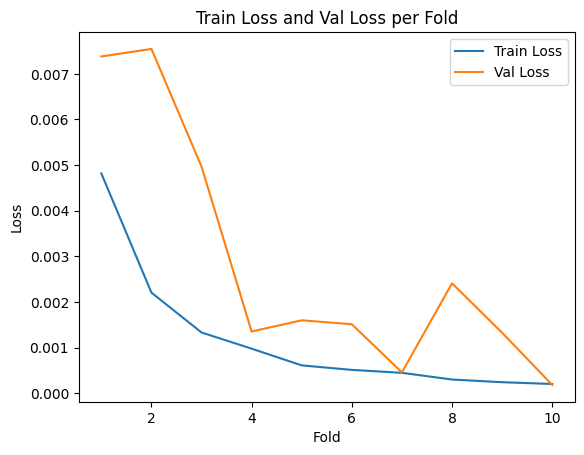

In [15]:
import matplotlib.pyplot as plt

# Mengambil nilai loss dari setiap fold
train_losses = []
val_losses = []

for fold in range(10):
    train_losses.append(H[f"train_loss_{fold}"][-1])  # Nilai loss terakhir pada epoch ke-50
    val_losses.append(H[f"test_loss_{fold}"][-1])  # Nilai loss terakhir pada epoch ke-50

# Memplot nilai loss tiap fold
plt.plot(range(1, 11), train_losses, label='Train Loss')
plt.plot(range(1, 11), val_losses, label='Val Loss')

plt.xlabel('Fold')
plt.ylabel('Loss')
plt.title('Train Loss and Val Loss per Fold')
plt.legend()
plt.show()

In [ ]:
# RUN THIS CELL IF USE 5 FOLD
import matplotlib.pyplot as plt
import numpy as np

# Inisialisasi array untuk menyimpan rata-rata loss dan DSC dari setiap fold
mean_train_loss = np.mean([H[f"train_loss_{fold}"][-1] for fold in range(5)])
mean_test_loss = np.mean([H[f"test_loss_{fold}"][-1] for fold in range(5)])
mean_dice_train = np.mean([H[f"dice_train_{fold}"][-1] for fold in range(5)])
mean_dice_val = np.mean([H[f"dice_val_{fold}"][-1] for fold in range(5)])

# Plot rata-rata loss
plt.figure(figsize=(10, 5))
plt.plot(range(1, 6), [H[f"train_loss_{fold}"][-1] for fold in range(5)], 'o-', label="Train Loss")
plt.plot(range(1, 6), [H[f"test_loss_{fold}"][-1] for fold in range(5)], 'o-', label="Validation Loss")
plt.xlabel("Fold")
plt.ylabel("Loss")
plt.title("Average Loss - 5-Fold Cross Validation")
plt.legend()
plt.show()

# Plot rata-rata DSC
plt.figure(figsize=(10, 5))
plt.plot(range(1, 6), [H[f"dice_train_{fold}"][-1] for fold in range(5)], 'o-', label="Train DSC")
plt.plot(range(1, 6), [H[f"dice_val_{fold}"][-1] for fold in range(5)], 'o-', label="Validation DSC")
plt.xlabel("Fold")
plt.ylabel("DSC")
plt.title("Average Dice Coefficient - 5-Fold Cross Validation")
plt.legend()
plt.show()

print(f"Mean Train Loss: {mean_train_loss:.4f}")
print(f"Mean Validation Loss: {mean_test_loss:.4f}")
print(f"Mean Train DSC: {mean_dice_train:.4f}")
print(f"Mean Validation DSC: {mean_dice_val:.4f}")

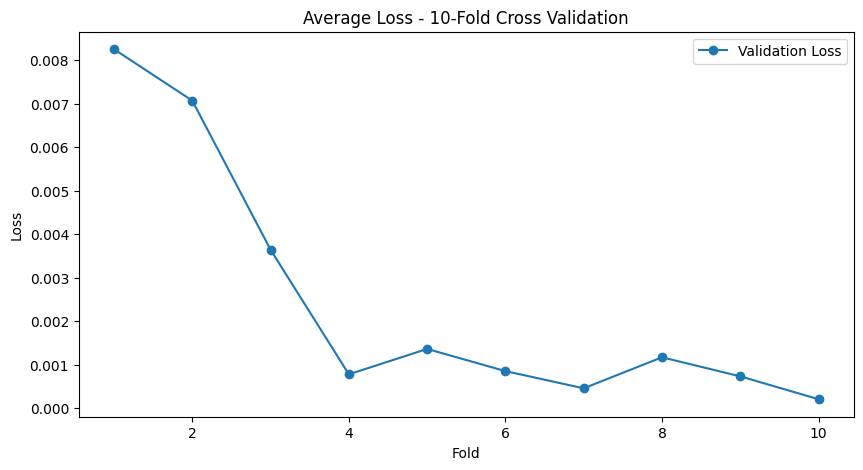

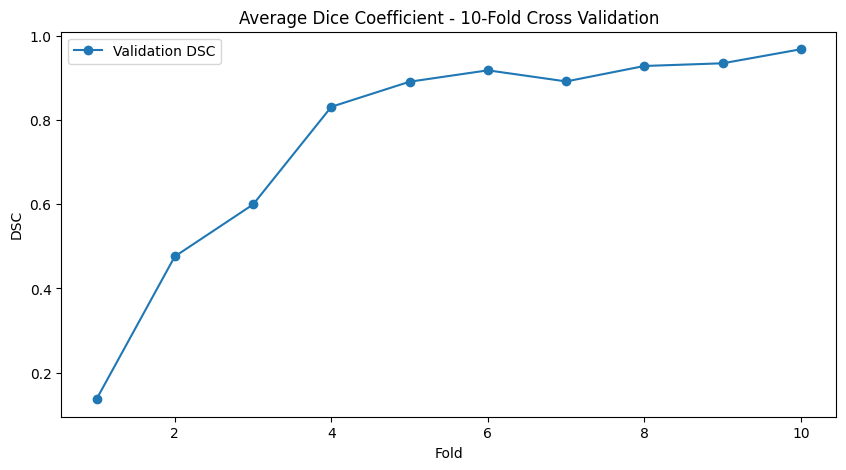

Mean Train Loss: 0.0004
Mean Validation Loss: 0.0024
Mean Train DSC: 0.9596
Mean Validation DSC: 0.7575


In [15]:
import matplotlib.pyplot as plt
import numpy as np

# Inisialisasi array untuk menyimpan rata-rata loss dan DSC dari setiap fold
mean_train_loss = np.mean([H[f"train_loss_{fold}"][-1] for fold in range(10)])
mean_test_loss = np.mean([H[f"test_loss_{fold}"][-1] for fold in range(10)])
mean_dice_train = np.mean([H[f"dice_train_{fold}"][-1] for fold in range(10)])
mean_dice_val = np.mean([H[f"dice_val_{fold}"][-1] for fold in range(10)])

# Plot rata-rata loss
plt.figure(figsize=(10, 5))
#plt.plot(range(1, 11), [H[f"train_loss_{fold}"][-1] for fold in range(10)], 'o-', label="Train Loss")
plt.plot(range(1, 11), [H[f"test_loss_{fold}"][-1] for fold in range(10)], 'o-', label="Validation Loss")
plt.xlabel("Fold")
plt.ylabel("Loss")
plt.title("Average Loss - 10-Fold Cross Validation")
plt.legend()
plt.show()

# Plot rata-rata DSC
plt.figure(figsize=(10, 5))
#plt.plot(range(1, 11), [H[f"dice_train_{fold}"][-1] for fold in range(10)], 'o-', label="Train DSC")
plt.plot(range(1, 11), [H[f"dice_val_{fold}"][-1] for fold in range(10)], 'o-', label="Validation DSC")
plt.xlabel("Fold")
plt.ylabel("DSC")
plt.title("Average Dice Coefficient - 10-Fold Cross Validation")
plt.legend()
plt.show()

print(f"Mean Train Loss: {mean_train_loss:.4f}")
print(f"Mean Validation Loss: {mean_test_loss:.4f}")
print(f"Mean Train DSC: {mean_dice_train:.4f}")
print(f"Mean Validation DSC: {mean_dice_val:.4f}")

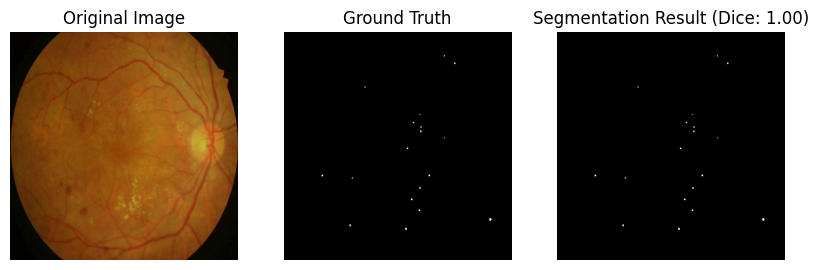

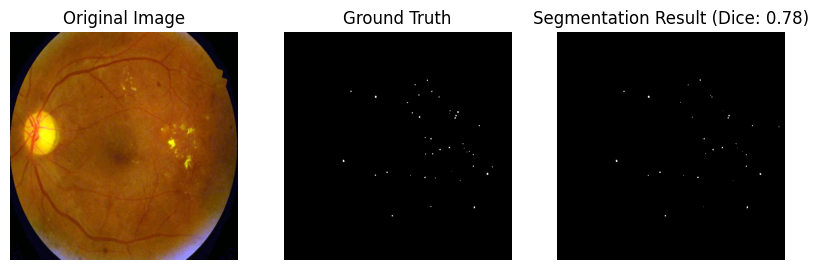

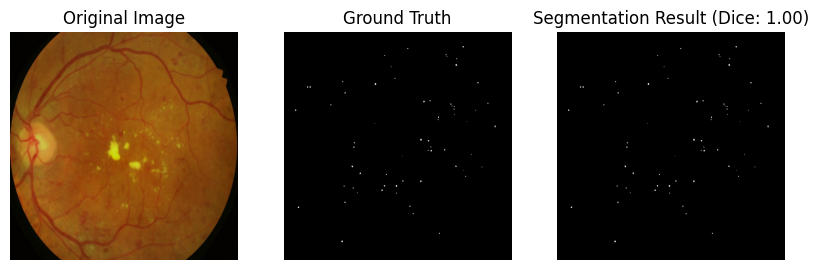

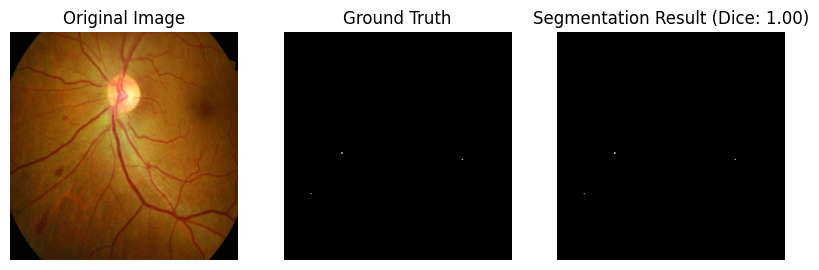

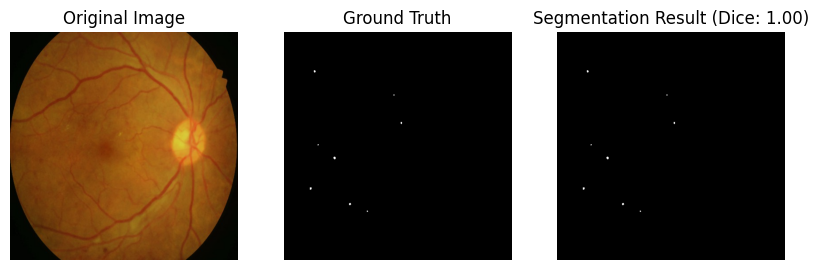

...

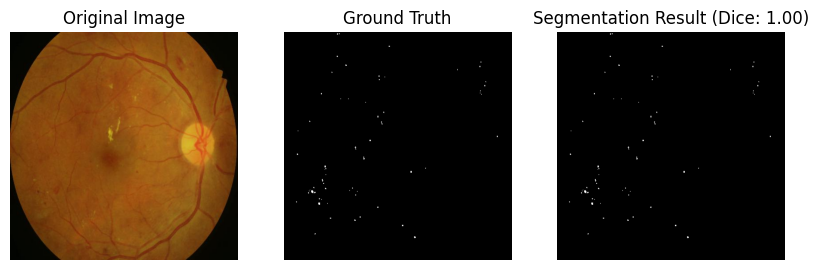

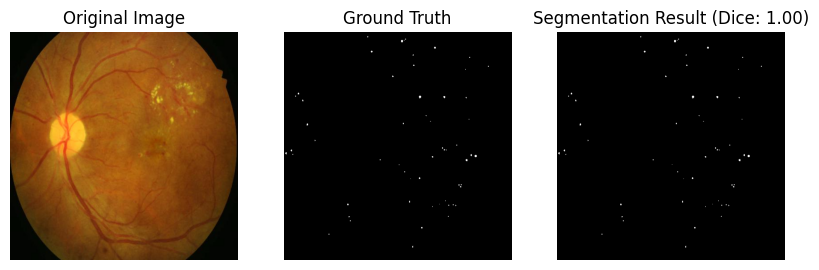

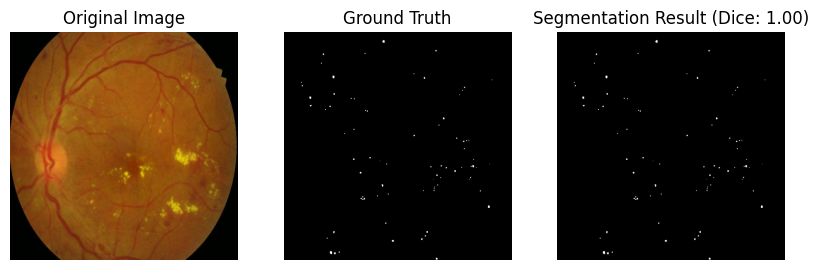

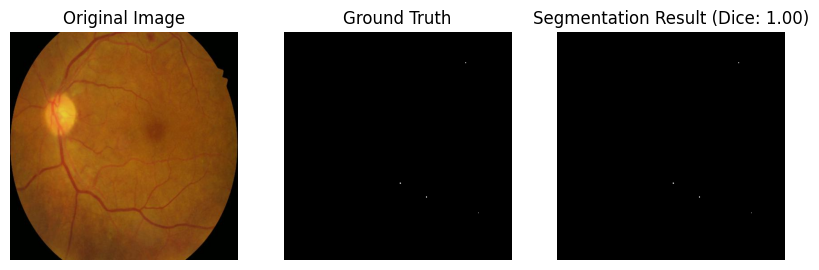

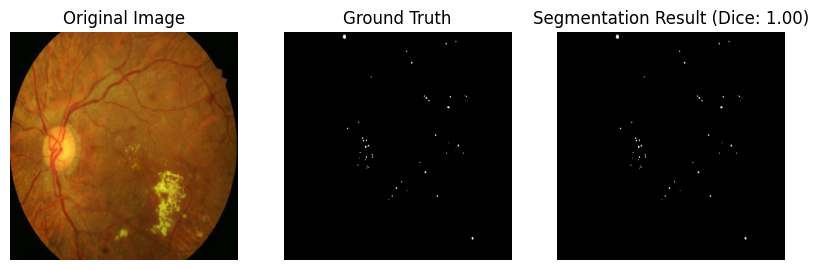

Average Dice coefficient: 0.99


In [16]:
from monai.metrics import DiceMetric
import numpy as np

test_x = sorted(glob("/drive0-storage/Anastasia/CROSS VAL DATA/TRAIN IMG/*"))
test_y = sorted(glob("/drive0-storage/Anastasia/CROSS VAL DATA/GT MA/*"))
test_dataset = ProcessDataset(test_x, test_y)

# load model yang telah dilatih
model.load_state_dict(torch.load('tesma10fold.pth'))

# Inisialisasi objek DiceMetric
dice_metric = DiceMetric(include_background=False, reduction="mean")

dice_scores = []  # Untuk menyimpan skor Dice coefficient dari setiap gambar

# Iterasi melalui setiap gambar di test dataset
for i, (x, y_true) in enumerate(test_dataset):
    # Kirim gambar ke model dan dapatkan hasil prediksi
    with torch.no_grad():
        model.eval()
        y_pred = torch.sigmoid(model(x.unsqueeze(0).to(device))).squeeze(0)
        y_pred = torch.round(y_pred)  # threshold

    # Hitung skor Dice coefficient
    dice_score = dice_metric(y_pred.unsqueeze(0), y_true.unsqueeze(0).to(device))

    dice_scores.append(dice_score.item())  # Tambahkan skor Dice coefficient ke daftar

    # Tampilkan gambar dan skor Dice coefficient
    x = x.permute(1, 2, 0).numpy()
    y_true = y_true.permute(1, 2, 0).cpu().numpy()
    y_pred = y_pred.cpu().permute(1, 2, 0).numpy()

    plt.figure(figsize=(10, 10))
    plt.subplot(1, 3, 1)
    plt.imshow(x, cmap='gray')
    plt.title('Original Image')
    plt.axis('off')
    plt.subplot(1, 3, 2)
    plt.imshow(y_true, cmap='gray')
    plt.title('Ground Truth')
    plt.axis('off')
    plt.subplot(1, 3, 3)
    plt.imshow(y_pred, cmap='gray')
    plt.title(f'Segmentation Result (Dice: {dice_score.item():.2f})')
    plt.axis('off')
    plt.show()

# Hitung rata-rata Dice coefficient dari seluruh gambar di test dataset
average_dice_score = np.mean(dice_scores)

print(f"Average Dice coefficient: {average_dice_score:.2f}")

In [66]:
normal_dir = "/drive0-storage/Anastasia/HASIL SEGMENTASI/MA NORMAL"
mild_dir = "/drive0-storage/Anastasia/HASIL SEGMENTASI/MA MILD"
mod_dir = "/drive0-storage/Anastasia/HASIL SEGMENTASI/MA MODERATE"
svr_dir = "/drive0-storage/Anastasia/HASIL SEGMENTASI/MA SEVERE"
pdr_dir = "/drive0-storage/Anastasia/HASIL SEGMENTASI/MA PDR"

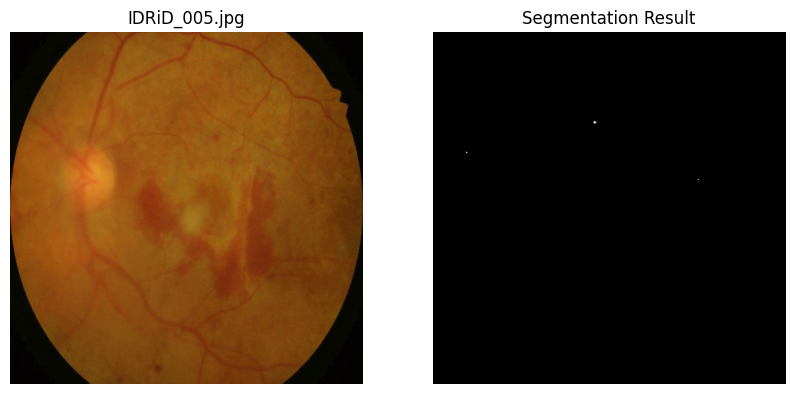

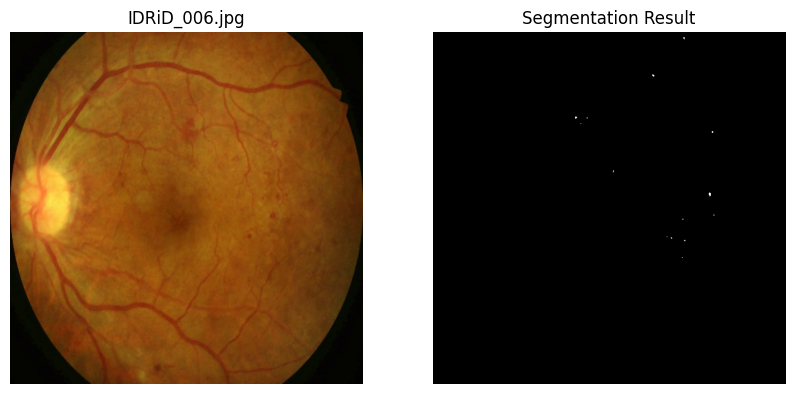

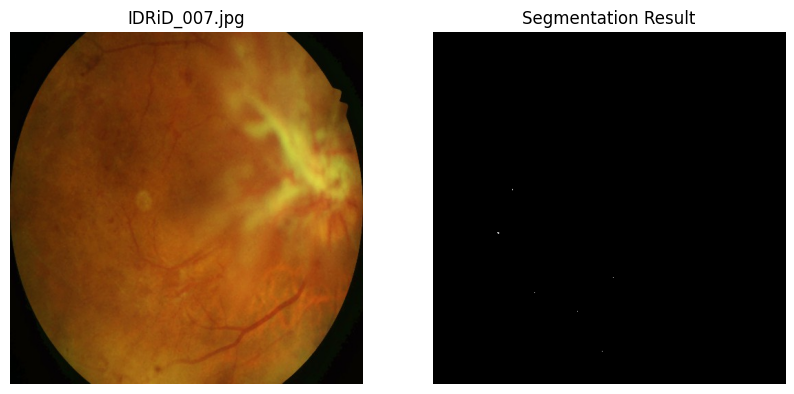

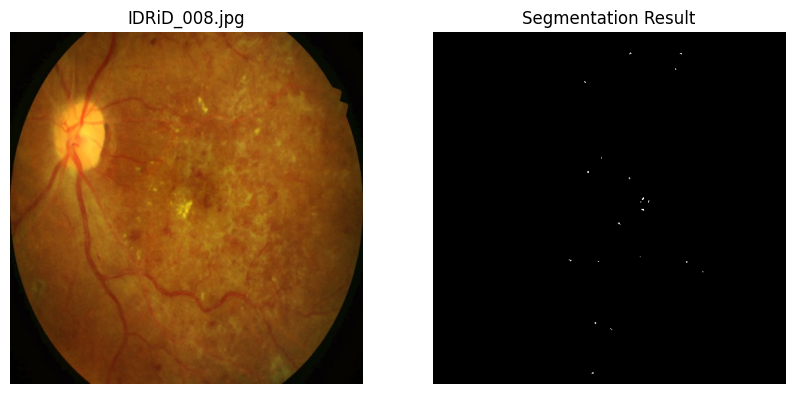

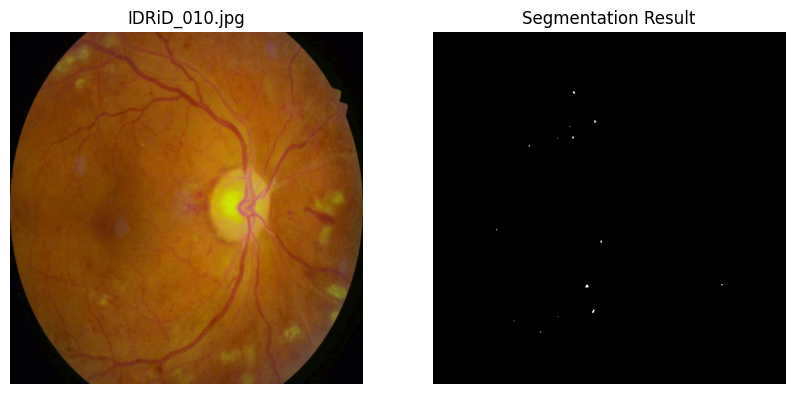

...

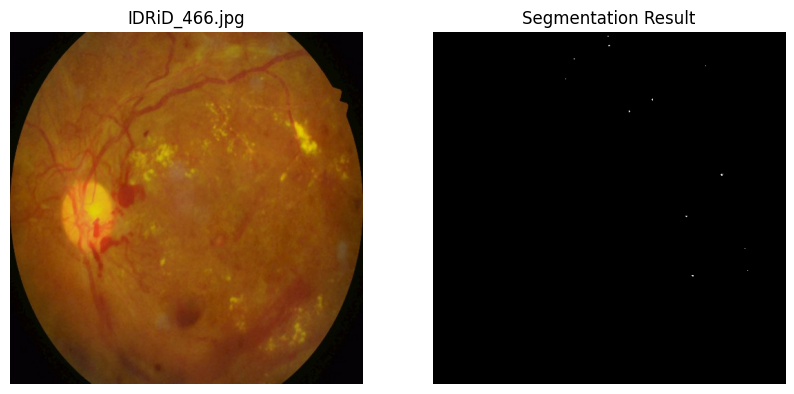

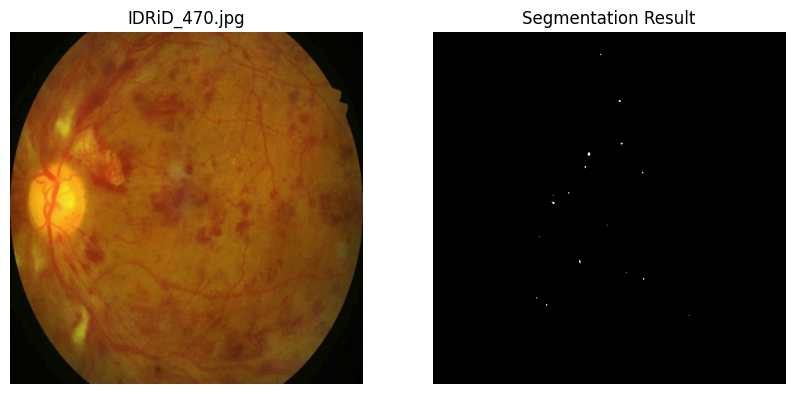

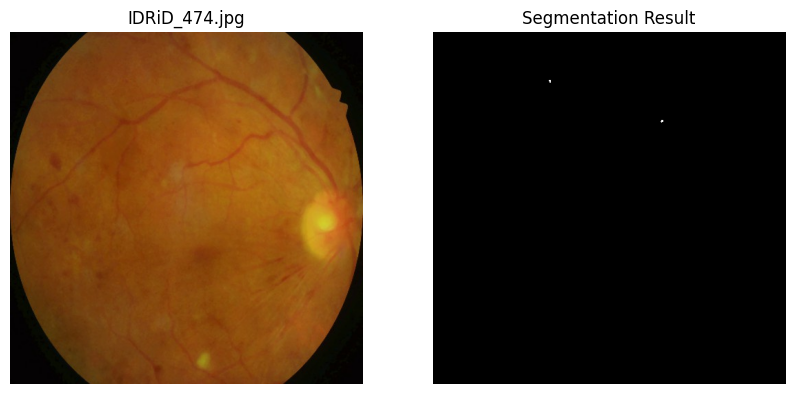

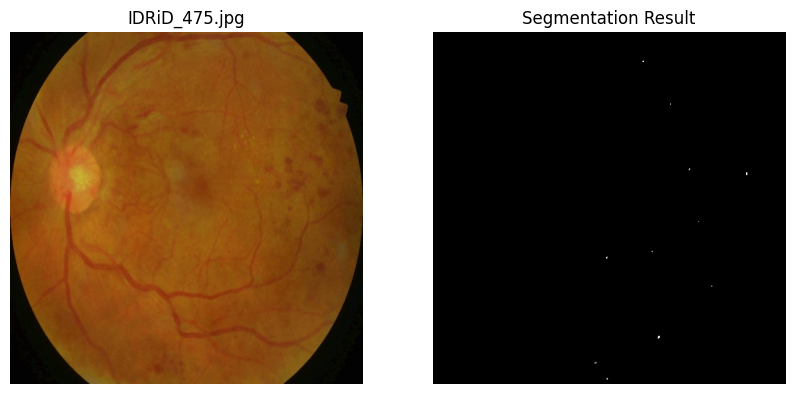

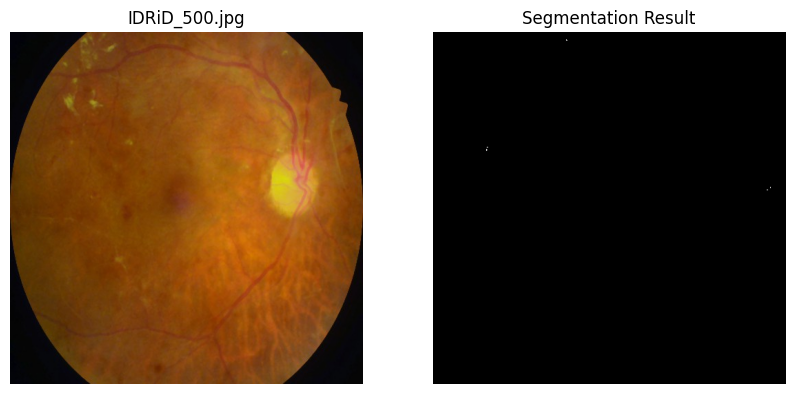

In [17]:
from torchvision import transforms
class ProcessDataset2(Dataset):
    def __init__(self, x):
        self.x = x

    def __len__(self):
        return len(self.x)

    def __getitem__(self, idx):
        img_x = Image.open(self.x[idx])
        img_x = transforms.ToTensor()(img_x)

        return img_x
    
test_path = sorted(glob("/drive0-storage/Anastasia/ALL DATASET/PDR/*"))

test_dataset = ProcessDataset2(test_path)

# load model yang telah dilatih
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = Build_Unet()
model.to(device)
model.load_state_dict(torch.load('tesma10fold.pth'))

# Tampilkan gambar asli, ground truth, dan hasil segmentasi beserta skor Dice coefficient
for i, (x) in enumerate(test_dataset):
    # Kirim gambar ke model dan dapatkan hasil prediksi
    with torch.no_grad():
        model.eval()
        y_pred = torch.sigmoid(model(x.unsqueeze(0).to(device))).squeeze(0)
        y_pred = torch.round(y_pred) # threshold

    # Tampilkan gambar 
    x = x.permute(1, 2, 0).numpy()
    y_pred = y_pred.cpu().permute(1, 2, 0).numpy()

    filename = os.path.basename(test_path[i])
    # Simpan gambar hasil prediksi ke dalam folder normal_dir
    # Normalisasi nilai piksel ke rentang [0, 255]
    y_pred1 = y_pred * 255
    y_pred1 = y_pred1.astype(np.float32)
    y_pred1 = np.squeeze(y_pred1, axis=-1)  # hapus axis terakhir
    
    #result_path = os.path.join(pdr_dir, filename.replace('.jpg', '.png'))
    #Image.fromarray(y_pred1.astype(np.uint8)).save(result_path)
    
    plt.figure(figsize=(10,10))
    plt.subplot(1,2,1)
    plt.imshow(x, cmap='gray')
    plt.title(f'{filename}')
    plt.axis('off')
    plt.subplot(1,2,2)
    plt.imshow(y_pred, cmap='gray')
    plt.title(f'Segmentation Result')
    plt.axis('off')
    plt.show()

In [57]:
torch.cuda.empty_cache()